In [1]:
!pip3 install -q xlrd xlwt
!pip3 install -q openpyxl
!pip3 install -q seaborn
# !pip3 install -q keras



In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns


# Make numpy printouts easier to read.
np.set_printoptions(precision=3, suppress=True)

In [3]:
rawDataset = pd.read_excel('vehicle_emission_1.xls', index_col=0)
rawDataset

,SN,Make,Yr,FuelType,VehicleUse,CO,CO2,O2,HC,lamda,Study,OGEPA,Age,VehicleType,EUROII,NESREAI,AFR,NESREAII,EUROIII
N,,,,,,,,,,,,,,,,,,,
1,1,Honda,2006,Petrol,Commercial,0.00,13.5,1.55,0,1.08,Passed,Passed,8,Car,Passed,Passed,15.876,Passed,Passed
2,2,Honda,2007,Petrol,Commercial,0.00,14.7,0.08,10,1.00,Passed,Passed,7,Jeep,Passed,Passed,14.744,Passed,Passed
3,3,Toyota,2011,Petrol,Commercial,0.00,14.6,0.72,1,1.04,Passed,Passed,3,Car,Passed,Passed,15.244,Passed,Passed
4,4,Toyota,1998,Petrol,Official,0.00,10.2,3.15,1,1.22,Passed,Passed,16,Car,Passed,Passed,17.934,Passed,Passed
5,5,Toyota,2002,Petrol,Official,0.00,14.5,0.60,1,1.03,Passed,Passed,12,Car,Passed,Passed,15.141,Passed,Passed
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2761,2796,Toyota,1987,Petrol,Private,4.49,5.8,11.29,603,1.51,Failed,Failed,27,Car,Failed,Failed,22.256,Passed,Failed
2762,2797,Toyota,2007,Petrol,Commercial,4.51,11.9,0.47,388,0.88,Failed,Failed,7,Car,Failed,Failed,12.995,Failed,Failed
2763,2798,Nissan,1984,Petrol,Private,4.51,10.9,1.55,203,0.93,Failed,Failed,30,Car,Failed,Failed,13.700,Failed,Failed


In [4]:
rawDataset.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2765 entries, 1 to 2765
Data columns (total 19 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   SN           2765 non-null   int64  
 1   Make         2765 non-null   object 
 2   Yr           2765 non-null   int64  
 3   FuelType     2765 non-null   object 
 4   VehicleUse   2765 non-null   object 
 5   CO           2765 non-null   float64
 6   CO2          2765 non-null   float64
 7   O2           2765 non-null   float64
 8   HC           2765 non-null   int64  
 9   lamda        2764 non-null   float64
 10  Study        2765 non-null   object 
 11  OGEPA        2765 non-null   object 
 12  Age          2765 non-null   int64  
 13  VehicleType  2765 non-null   object 
 14  EUROII       2765 non-null   object 
 15  NESREAI      2765 non-null   object 
 16  AFR          2765 non-null   float64
 17  NESREAII     2765 non-null   object 
 18  EUROIII      2765 non-null   object 
dtypes: flo

In [5]:
dataset = rawDataset.copy()
dataset.head()

,SN,Make,Yr,FuelType,VehicleUse,CO,CO2,O2,HC,lamda,Study,OGEPA,Age,VehicleType,EUROII,NESREAI,AFR,NESREAII,EUROIII
N,,,,,,,,,,,,,,,,,,,
1,1,Honda,2006,Petrol,Commercial,0.0,13.5,1.55,0,1.08,Passed,Passed,8,Car,Passed,Passed,15.876,Passed,Passed
2,2,Honda,2007,Petrol,Commercial,0.0,14.7,0.08,10,1.00,Passed,Passed,7,Jeep,Passed,Passed,14.744,Passed,Passed
3,3,Toyota,2011,Petrol,Commercial,0.0,14.6,0.72,1,1.04,Passed,Passed,3,Car,Passed,Passed,15.244,Passed,Passed
4,4,Toyota,1998,Petrol,Official,0.0,10.2,3.15,1,1.22,Passed,Passed,16,Car,Passed,Passed,17.934,Passed,Passed
5,5,Toyota,2002,Petrol,Official,0.0,14.5,0.60,1,1.03,Passed,Passed,12,Car,Passed,Passed,15.141,Passed,Passed


In [6]:
dataset.isna().sum()

SN             0
Make           0
Yr             0
FuelType       0
VehicleUse     0
CO             0
CO2            0
O2             0
HC             0
lamda          1
Study          0
OGEPA          0
Age            0
VehicleType    0
EUROII         0
NESREAI        0
AFR            0
NESREAII       0
EUROIII        0
dtype: int64

In [7]:
dataset = dataset.dropna()

In [8]:
boolCols = ['Study', 'OGEPA', 'EUROII', 'NESREAI', 'NESREAII', 'EUROIII']

for col in boolCols:
    dict_colData = { x:i+2 for i,x in enumerate(rawDataset[col].unique())}
    dict_colData['Failed']=0
    dict_colData['Passed']=1
    print(dict_colData)
    dataset[col] = dataset[col].map(dict_colData)
    
# dataset = pd.get_dummies(dataset, prefix=prefix, prefix_sep='_')
dataset

{'Passed': 1, 'Failed': 0}
{'Passed': 1, 'Failed': 0}
{'Passed': 1, 'Failed': 0}
{'Passed': 1, 'Failed': 0}
{'Passed': 1, 'Failed': 0}
{'Passed': 1, 'Failed': 0}


,SN,Make,Yr,FuelType,VehicleUse,CO,CO2,O2,HC,lamda,Study,OGEPA,Age,VehicleType,EUROII,NESREAI,AFR,NESREAII,EUROIII
N,,,,,,,,,,,,,,,,,,,
1,1,Honda,2006,Petrol,Commercial,0.00,13.5,1.55,0,1.08,1,1,8,Car,1,1,15.876,1,1
2,2,Honda,2007,Petrol,Commercial,0.00,14.7,0.08,10,1.00,1,1,7,Jeep,1,1,14.744,1,1
3,3,Toyota,2011,Petrol,Commercial,0.00,14.6,0.72,1,1.04,1,1,3,Car,1,1,15.244,1,1
4,4,Toyota,1998,Petrol,Official,0.00,10.2,3.15,1,1.22,1,1,16,Car,1,1,17.934,1,1
5,5,Toyota,2002,Petrol,Official,0.00,14.5,0.60,1,1.03,1,1,12,Car,1,1,15.141,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2761,2796,Toyota,1987,Petrol,Private,4.49,5.8,11.29,603,1.51,0,0,27,Car,0,0,22.256,1,0
2762,2797,Toyota,2007,Petrol,Commercial,4.51,11.9,0.47,388,0.88,0,0,7,Car,0,0,12.995,0,0
2763,2798,Nissan,1984,Petrol,Private,4.51,10.9,1.55,203,0.93,0,0,30,Car,0,0,13.700,0,0


In [9]:
prefix = ['Make', 'FuelType', 'VehicleUse', 'VehicleType']
dataset = pd.get_dummies(dataset, prefix=prefix, prefix_sep='_')
dataset

,SN,Yr,CO,CO2,O2,HC,lamda,Study,OGEPA,Age,...,VehicleUse_Commercial,VehicleUse_Official,VehicleUse_Private,VehicleType_Bullion V,VehicleType_Bus,VehicleType_CABSTAR,VehicleType_Car,VehicleType_Jeep,VehicleType_PICK-UP,VehicleType_TRUCK
N,,,,,,,,,,,,,,,,,,,,,
1,1,2006,0.00,13.5,1.55,0,1.08,1,1,8,...,1,0,0,0,0,0,1,0,0,0
2,2,2007,0.00,14.7,0.08,10,1.00,1,1,7,...,1,0,0,0,0,0,0,1,0,0
3,3,2011,0.00,14.6,0.72,1,1.04,1,1,3,...,1,0,0,0,0,0,1,0,0,0
4,4,1998,0.00,10.2,3.15,1,1.22,1,1,16,...,0,1,0,0,0,0,1,0,0,0
5,5,2002,0.00,14.5,0.60,1,1.03,1,1,12,...,0,1,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2761,2796,1987,4.49,5.8,11.29,603,1.51,0,0,27,...,0,0,1,0,0,0,1,0,0,0
2762,2797,2007,4.51,11.9,0.47,388,0.88,0,0,7,...,1,0,0,0,0,0,1,0,0,0
2763,2798,1984,4.51,10.9,1.55,203,0.93,0,0,30,...,0,0,1,0,0,0,1,0,0,0


In [10]:
dataset.columns

Index(['SN', 'Yr', 'CO', 'CO2', 'O2', 'HC', 'lamda', 'Study', 'OGEPA', 'Age',
       'EUROII', 'NESREAI', 'AFR', 'NESREAII', 'EUROIII', 'Make_Honda',
       'Make_Mazda', 'Make_Mercedez B', 'Make_Mitsubushi', 'Make_Nissan',
       'Make_Peugeot', 'Make_Toyota', 'Make_Volkswagen', 'FuelType_Petrol',
       'VehicleUse_Commercial', 'VehicleUse_Official', 'VehicleUse_Private',
       'VehicleType_Bullion V', 'VehicleType_Bus', 'VehicleType_CABSTAR',
       'VehicleType_Car', 'VehicleType_Jeep', 'VehicleType_PICK-UP',
       'VehicleType_TRUCK'],
      dtype='object')

In [11]:
favCols = ['CO', 'CO2', 'O2', 'HC', 'Age', 'lamda', 'AFR', 'Study']

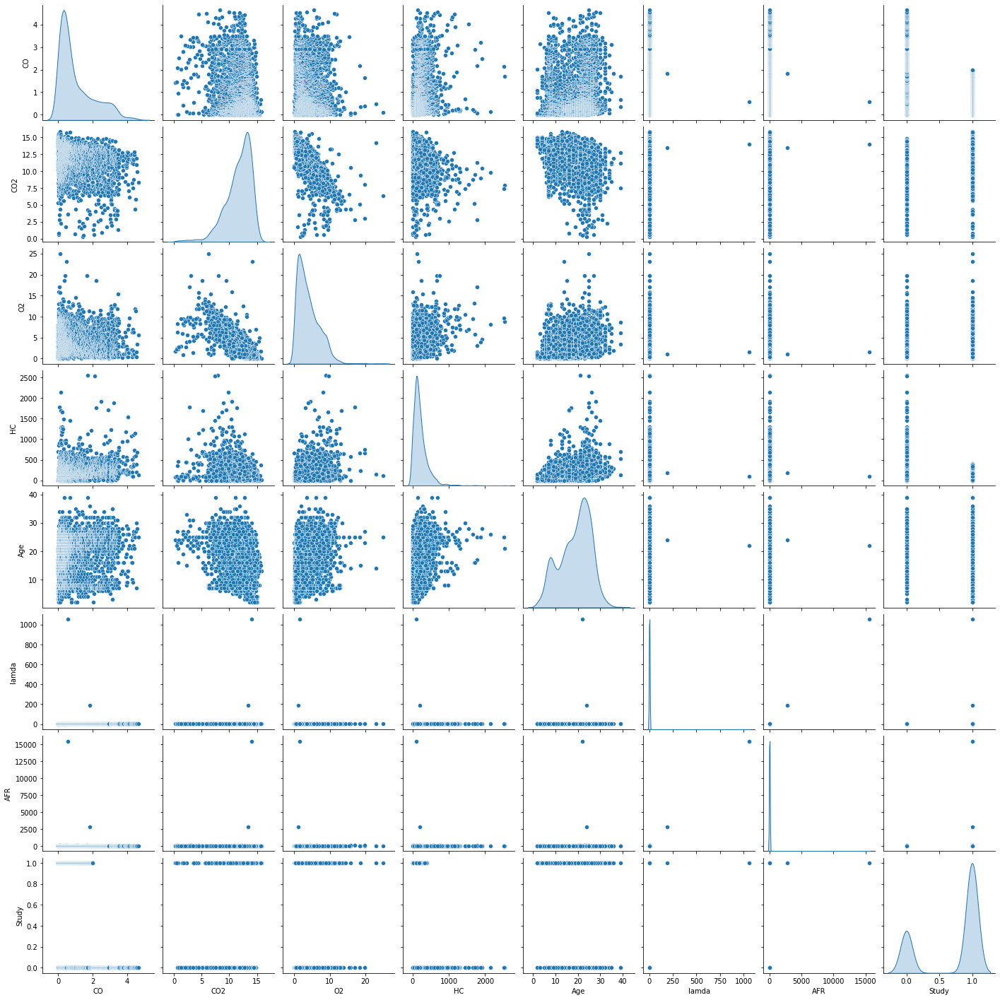

In [12]:
sns.pairplot(dataset[favCols], diag_kind='kde')

In [13]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2764 entries, 1 to 2765
Data columns (total 34 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   SN                     2764 non-null   int64  
 1   Yr                     2764 non-null   int64  
 2   CO                     2764 non-null   float64
 3   CO2                    2764 non-null   float64
 4   O2                     2764 non-null   float64
 5   HC                     2764 non-null   int64  
 6   lamda                  2764 non-null   float64
 7   Study                  2764 non-null   int64  
 8   OGEPA                  2764 non-null   int64  
 9   Age                    2764 non-null   int64  
 10  EUROII                 2764 non-null   int64  
 11  NESREAI                2764 non-null   int64  
 12  AFR                    2764 non-null   float64
 13  NESREAII               2764 non-null   int64  
 14  EUROIII                2764 non-null   int64  
 15  Make

In [14]:
dataset.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
SN,2764.0,1415.722865,802.523630,1.000,727.7500,1418.500,2109.2500,2800.00
Yr,2764.0,1995.152315,6.863460,1975.000,1990.0000,1994.000,2000.0000,2012.00
CO,2764.0,1.037435,1.016247,0.000,0.2800,0.610,1.5800,4.65
CO2,2764.0,11.625315,2.363758,0.300,10.4000,12.100,13.4000,15.80
O2,2764.0,3.964012,3.017331,0.020,1.5475,3.210,5.7450,25.00
HC,2764.0,210.441027,217.624778,0.000,94.0000,158.000,273.2500,2547.00
lamda,2764.0,1.680340,20.366994,0.010,1.0400,1.140,1.3200,1055.00
Study,2764.0,0.722504,0.447845,0.000,0.0000,1.000,1.0000,1.00
OGEPA,2764.0,0.894356,0.307437,0.000,1.0000,1.000,1.0000,1.00
Age,2764.0,18.847685,6.863460,2.000,14.0000,20.000,24.0000,39.00


In [15]:
interestCols =['CO', 'CO2', 'O2', 'HC', 'lamda', 'AFR', 'Study', 'Age', 'Make_Honda','Make_Mazda', 'Make_Mercedez B', 'Make_Mitsubushi', 'Make_Nissan',
       'Make_Peugeot', 'Make_Toyota', 'Make_Volkswagen', 'FuelType_Petrol',
       'VehicleUse_Commercial', 'VehicleUse_Official', 'VehicleUse_Private',
       'VehicleType_Bullion V', 'VehicleType_Bus', 'VehicleType_CABSTAR',
       'VehicleType_Car', 'VehicleType_Jeep', 'VehicleType_PICK-UP',
       'VehicleType_TRUCK']
interestCols

['CO',
 'CO2',
 'O2',
 'HC',
 'lamda',
 'AFR',
 'Study',
 'Age',
 'Make_Honda',
 'Make_Mazda',
 'Make_Mercedez B',
 'Make_Mitsubushi',
 'Make_Nissan',
 'Make_Peugeot',
 'Make_Toyota',
 'Make_Volkswagen',
 'FuelType_Petrol',
 'VehicleUse_Commercial',
 'VehicleUse_Official',
 'VehicleUse_Private',
 'VehicleType_Bullion V',
 'VehicleType_Bus',
 'VehicleType_CABSTAR',
 'VehicleType_Car',
 'VehicleType_Jeep',
 'VehicleType_PICK-UP',
 'VehicleType_TRUCK']

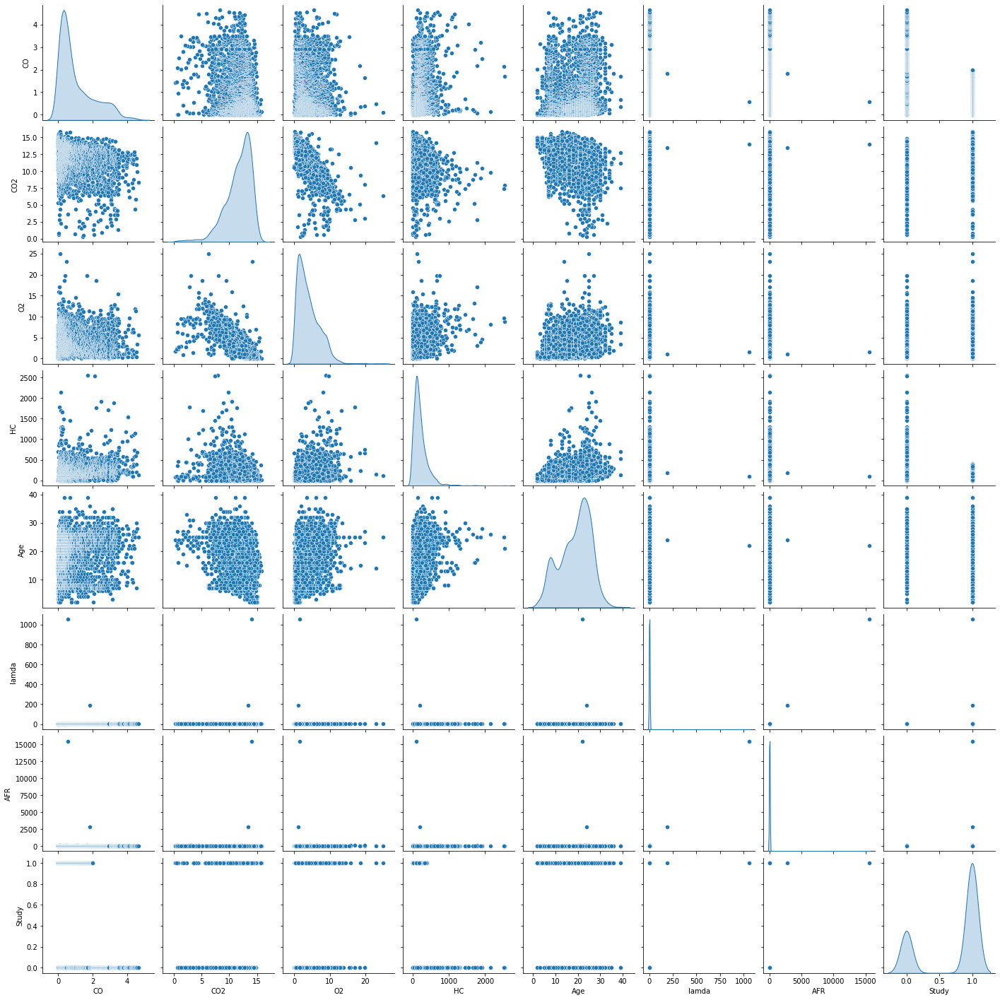

In [16]:
h = 1
dataX = dataset[interestCols].copy()
X = dataX.loc[::h]
sns.pairplot(X[favCols], diag_kind='kde')

<ipython-input-17-980ca8bf8007>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


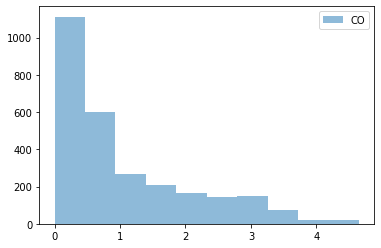

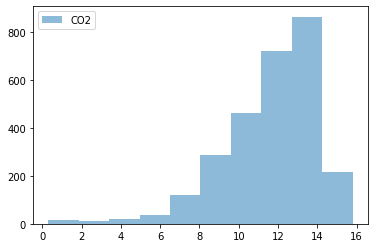

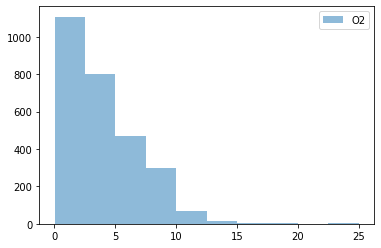

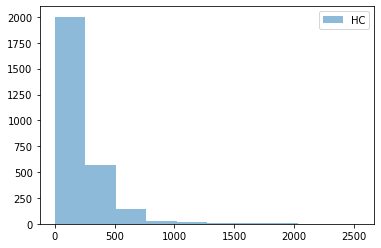

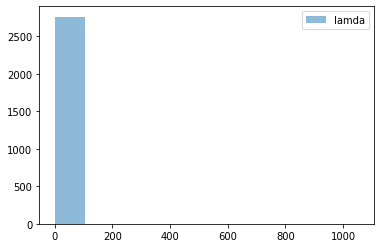

...

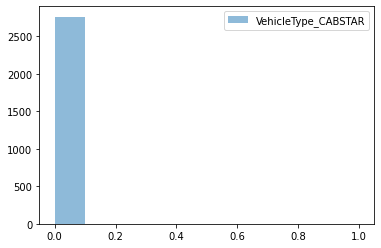

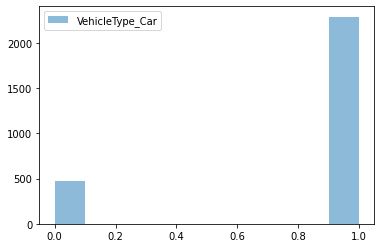

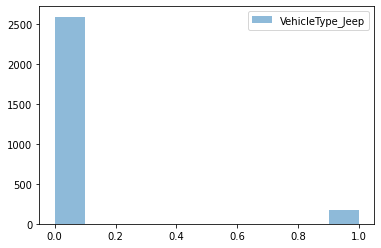

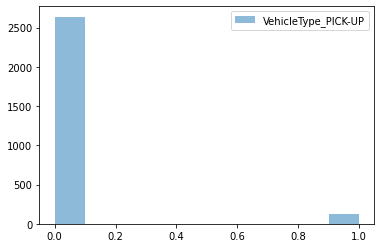

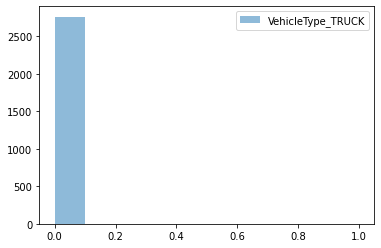

In [17]:
colNames = X.columns

for col in colNames:
    fig, ax = plt.subplots()      
    ax.hist(X[col], 10,  
    # facecolor='red',
    alpha=0.5, label=col)

    ax.legend()

# fig.subplots_adjust(left=0, right=1, bottom=0, top=0.5, hspace=0.05, wspace=1)

plt.show()

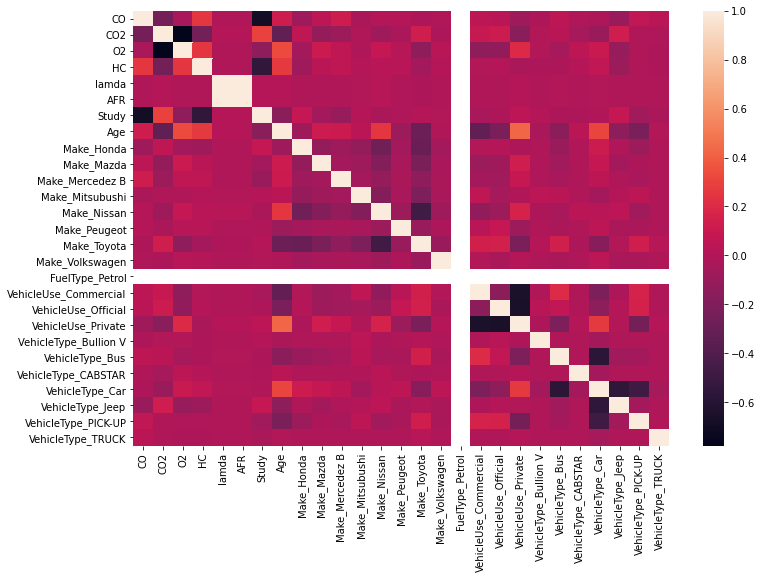

In [20]:
corr = X.corr()

fig, ax = plt.subplots(figsize=(12,8))

sns.heatmap(corr, 
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values, 
            ax=ax)
plt.show()

In [21]:
correlatedCols =['CO', 'CO2', 'O2', 'HC', 'Study', 'Age', 'Make_Honda','Make_Mazda', 'Make_Mercedez B', 'Make_Mitsubushi', 'Make_Nissan',
       'Make_Peugeot', 'Make_Toyota', 'Make_Volkswagen', 'FuelType_Petrol',
       'VehicleUse_Commercial', 'VehicleUse_Official', 'VehicleUse_Private',
       'VehicleType_Bullion V', 'VehicleType_Bus', 'VehicleType_CABSTAR',
       'VehicleType_Car', 'VehicleType_Jeep', 'VehicleType_PICK-UP',
       'VehicleType_TRUCK']

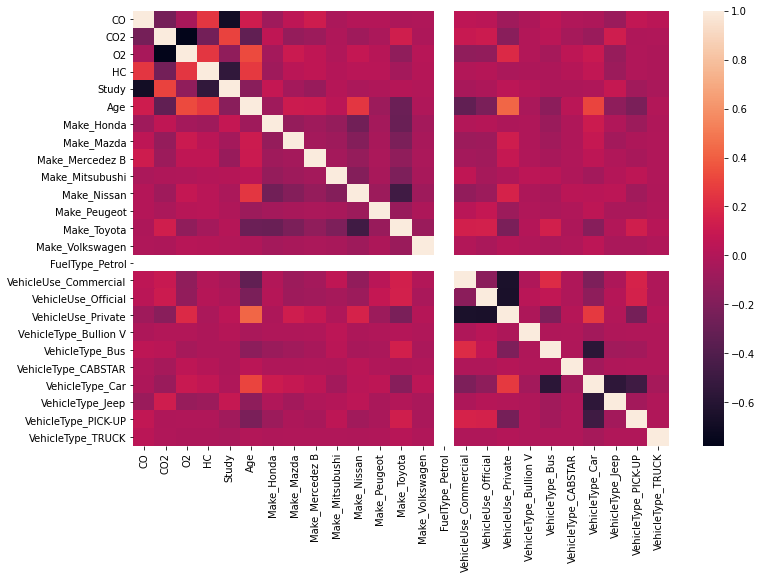

In [23]:

X = X[correlatedCols]
corr = X.corr()

fig, ax = plt.subplots(figsize=(12,8))

sns.heatmap(corr, 
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values, 
            ax=ax)
plt.show()

In [41]:
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers.experimental import preprocessing

print(tf.__version__)

2.4.1


In [101]:
def build_and_compile_model(norm, optimizer, loss, metrics=None):
    model = keras.Sequential([
      norm,
      layers.Dense(64, activation='relu'),
      layers.Dense(64, activation='relu'),
      layers.Dense(1)
      ])

    # model.compile(loss='mean_absolute_error', optimizer=tf.keras.optimizers.Adam(0.001))
    model.compile(optimizer=optimizer, loss=loss, metrics=metrics)

    return model

In [102]:
def plot_loss(history, ylabel='Error [Y]'):
    fig, ax = plt.subplots()
    ax.plot(history.history['loss'], label='loss')
    ax.plot(history.history['val_loss'], label='val_loss')
    #   ax.ylim([0, 10])
    ax.set_xlabel('Epoch')
    ax.set_ylabel(ylabel)
    ax.legend()
    ax.grid(True)

    plt.show()

In [106]:
from sklearn.model_selection import train_test_split


X = dataX.loc[::h]

label = 'CO2'

#  Isolate target labels
y = X[label]

# Isolate data
X = X.drop(label, axis=1) 

# Split the data up in train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [113]:
from sklearn.metrics import r2_score

normalizer = preprocessing.Normalization()

# optimizers
rmsprop = keras.optimizers.RMSprop(lr=0.01)
adam = tf.optimizers.Adam(learning_rate=0.01)
optimizer = rmsprop

# loss
loss='mae'

# metrics
metrics=['mse']

# model
model = build_and_compile_model(normalizer, optimizer, loss, metrics)

# fit
history = model.fit(X_train, y_train, 
    epochs=10, 
    verbose=1,
    # Calculate validation results on 20% of the training data
    validation_split = 0.2)


loss_value, metrics_value = model.evaluate(X_test, y_test, verbose=0)

y_pred = model.predict(X_test)
r2 = r2_score(y_test, y_pred)
    
print(loss_value, metrics_value, r2)

Epoch 1/10
47/47 [==============================] - 5s 28ms/step - loss: 30.7263 - mse: 24262.2897 - val_loss: 5.6730 - val_mse: 90.0671
Epoch 2/10
47/47 [==============================] - 1s 11ms/step - loss: 9.9347 - mse: 46800.9741 - val_loss: 4.1946 - val_mse: 31.3555
Epoch 3/10
47/47 [==============================] - 1s 11ms/step - loss: 8.6640 - mse: 20351.7076 - val_loss: 2.4791 - val_mse: 12.7539
Epoch 4/10
47/47 [==============================] - 1s 15ms/step - loss: 4.3282 - mse: 1119.1693 - val_loss: 3.2519 - val_mse: 21.6359
Epoch 5/10
47/47 [==============================] - 1s 17ms/step - loss: 9.4662 - mse: 37453.1682 - val_loss: 6.1441 - val_mse: 44.1312
Epoch 6/10
47/47 [==============================] - 1s 15ms/step - loss: 3.5927 - mse: 19.7581 - val_loss: 1.8352 - val_mse: 6.4131
Epoch 7/10
47/47 [==============================] - 0s 10ms/step - loss: 4.2094 - mse: 5993.5007 - val_loss: 3.5928 - val_mse: 21.6339
Epoch 8/10
47/47 [==============================] - 1

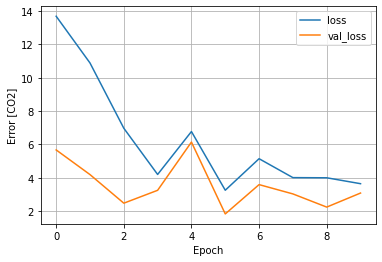

In [114]:
plot_loss(history, 'Error [CO2]')

In [116]:
for i in range(5):
    history = model.fit(X_train, y_train, epochs=10, verbose=0)
    loss_value, metrics_value = model.evaluate(X_test, y_test, verbose=0)

    y_pred = model.predict(X_test)
    r2 = r2_score(y_test, y_pred)
        
    print(loss_value, metrics_value, r2)

0.7589489817619324 1.6916227340698242 0.6783175933288436
1.0086150169372559 2.189519166946411 0.5836364990494443
0.8380905985832214 1.872210144996643 0.6439767133291746
0.8995741009712219 1.8221205472946167 0.6535018097069836
0.6672897338867188 1.5140693187713623 0.7120814866241773
